In [16]:
import torch
import torchvision
import torch.nn as nn
import math
import torch.nn.functional as F
import numpy as np
import torchvision.transforms as transforms
import matplotlib.pyplot as plt

from time import time
import cv2
import seaborn as sns
import os
from torch.utils.data import TensorDataset,DataLoader

num_epochs = 50 #50
batch_size_train = 32
batch_size_test = 32
learning_rate = 0.005
momentum = 0.5
log_interval = 500
input_size = 784
device = torch.device("cuda" if torch.cuda.is_available else "cpu")

In [2]:
trainset = torchvision.datasets.EMNIST(root='./mnist_data',
                                      split='letters',
                                             train=True, 
                                             transform=transforms.ToTensor(),
                                             download=False)
testset = torchvision.datasets.EMNIST(root='./mnist_data', 
                                     split='letters',
                                          train=False, 
                                          transform=transforms.ToTensor(),
                                          download=False)

In [3]:
len(trainset)

124800

In [4]:
len(testset)

20800

In [3]:
train_loader = torch.utils.data.DataLoader(
    trainset,
    batch_size=8,
    shuffle=True
)
test_loader = torch.utils.data.DataLoader(
    testset,
    batch_size=8,
    shuffle=False
)


In [4]:
len(trainset.classes)

27

In [5]:
testset.classes

['N/A',
 'a',
 'b',
 'c',
 'd',
 'e',
 'f',
 'g',
 'h',
 'i',
 'j',
 'k',
 'l',
 'm',
 'n',
 'o',
 'p',
 'q',
 'r',
 's',
 't',
 'u',
 'v',
 'w',
 'x',
 'y',
 'z']

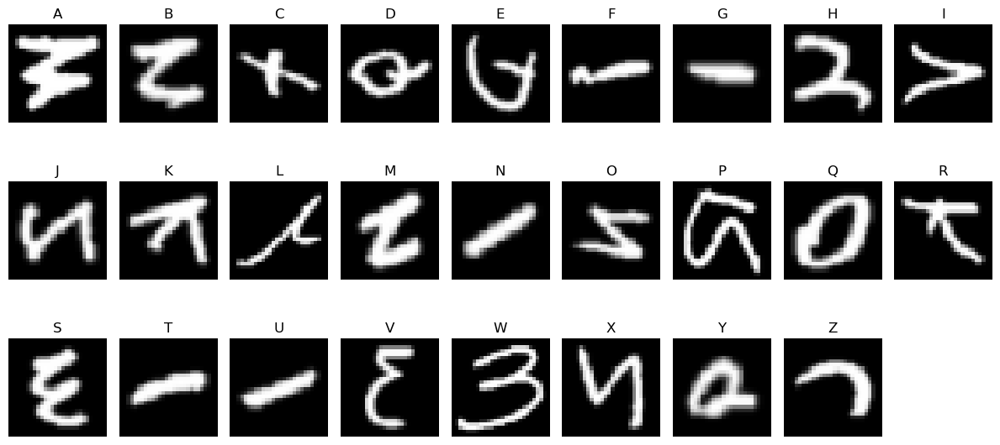

In [4]:
def imshow(img, title):
    img = img.numpy().squeeze()
    plt.imshow(img, cmap='gray')
    plt.title(title)
    plt.axis('off')

image_set = []
label_set=[]
samples = {i: None for i in range(1, 27)}  # 1 to 26 for EMNIST letters
for img, label in trainset:
    if(label!='N/A'):
       if samples[label] is None:
           samples[label] = img
       if all(v is not None for v in samples.values()):
           break

index_to_letter = {i: chr(i + ord('A') - 1) for i in range(1, 27)}

plt.figure(figsize=(12, 6))
for idx, (label, img) in enumerate(samples.items(), start=1):
    image_set.append(img)
    label_set.append(label)
    plt.subplot(3, 9, idx)
    imshow(img, index_to_letter[label])

plt.tight_layout()
plt.show()

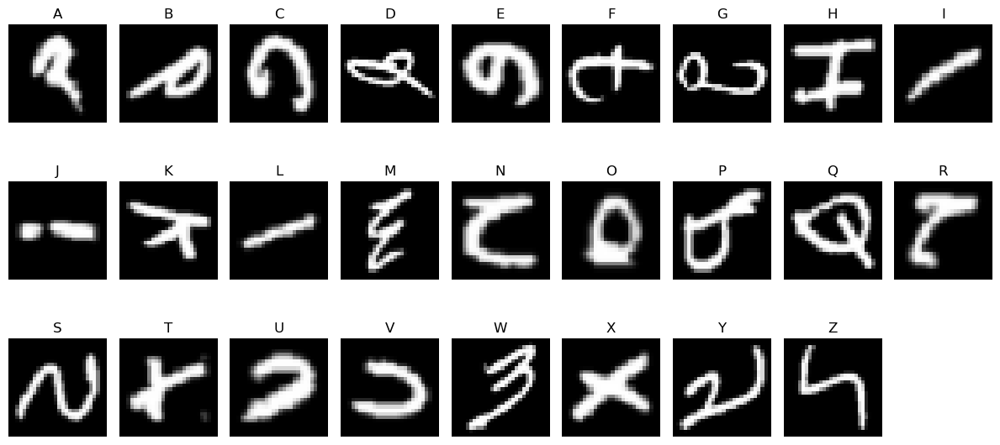

In [5]:
def imshow(img, title):
    img = img.numpy().squeeze()
    plt.imshow(img, cmap='gray')
    plt.title(title)
    plt.axis('off')

image_set2 = []
label_set2=[]
samples2 = {i: None for i in range(1, 27)}  # 1 to 26 for EMNIST letters
for img, label in testset:
    if samples2[label] is None:
        samples2[label] = img
    if all(v is not None for v in samples2.values()):
        break

index_to_letter2 = {i: chr(i + ord('A') - 1) for i in range(1, 27)}

plt.figure(figsize=(12, 6))
for idx, (label, img) in enumerate(samples2.items(), start=1):
    image_set2.append(img)
    label_set2.append(label)
    plt.subplot(3, 9, idx)
    imshow(img, index_to_letter2[label])

plt.tight_layout()
plt.show()

1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1


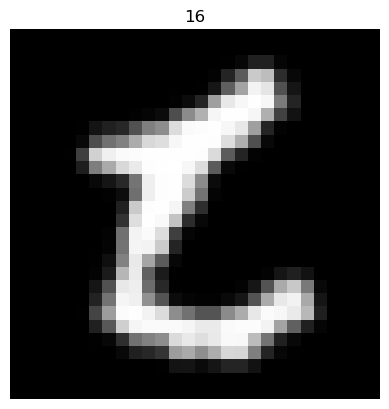

In [7]:
t = 0
for img, label in trainset:
    print(label)
    if label==16:
        imshow(img,label)
        t=t+1
    if(t>10):
        break

In [6]:
class VGG(nn.Module):
    """
    Based on - https://github.com/kkweon/mnist-competition
    from: https://github.com/ranihorev/Kuzushiji_MNIST/blob/master/KujuMNIST.ipynb
    """
    def two_conv_pool(self, in_channels, f1, f2):
        s = nn.Sequential(
            nn.Conv2d(in_channels, f1, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(f1),
            nn.ReLU(inplace=True),
            nn.Conv2d(f1, f2, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(f2),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=2, stride=2),
        )
        for m in s.children():
            if isinstance(m, nn.Conv2d):
                n = m.kernel_size[0] * m.kernel_size[1] * m.out_channels
                m.weight.data.normal_(0, math.sqrt(2. / n))
            elif isinstance(m, nn.BatchNorm2d):
                m.weight.data.fill_(1)
                m.bias.data.zero_()
        return s

    def three_conv_pool(self,in_channels, f1, f2, f3):
        s = nn.Sequential(
            nn.Conv2d(in_channels, f1, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(f1),
            nn.ReLU(inplace=True),
            nn.Conv2d(f1, f2, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(f2),
            nn.ReLU(inplace=True),
            nn.Conv2d(f2, f3, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(f3),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=2, stride=2),
        )
        for m in s.children():
            if isinstance(m, nn.Conv2d):
                n = m.kernel_size[0] * m.kernel_size[1] * m.out_channels
                m.weight.data.normal_(0, math.sqrt(2. / n))
            elif isinstance(m, nn.BatchNorm2d):
                m.weight.data.fill_(1)
                m.bias.data.zero_()
        return s


    def __init__(self, num_classes=26):
        super(VGG, self).__init__()
        self.l1 = self.two_conv_pool(1, 64, 64)
        #self.l2 = self.two_conv_pool(64, 128, 128)
        #self.l3 = self.three_conv_pool(128, 256, 256, 256)
        #self.l4 = self.three_conv_pool(256, 256, 256, 256)

        self.classifier = nn.Sequential(
            nn.Dropout(p = 0.5),
            nn.Linear(256, 512),
            nn.BatchNorm1d(512),
            nn.ReLU(inplace=True),
            nn.Dropout(p = 0.5),
            nn.Linear(512, num_classes),
        )

    def forward(self, x):
        x = self.l1(x)
        #x = self.l2(x)
        #x = self.l3(x)
        #x = self.l4(x)
        x = x.view(x.size(0), -1)
        x = self.classifier(x)
        return F.log_softmax(x, dim=1)


Half_width =128
layer_width =128

class SpinalVGG(nn.Module):
    """
    Based on - https://github.com/kkweon/mnist-competition
    from: https://github.com/ranihorev/Kuzushiji_MNIST/blob/master/KujuMNIST.ipynb
    """
    def two_conv_pool(self, in_channels, f1, f2):
        s = nn.Sequential(
            nn.Conv2d(in_channels, f1, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(f1),
            nn.ReLU(inplace=True),
            nn.Conv2d(f1, f2, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(f2),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=2, stride=2),
        )
        for m in s.children():
            if isinstance(m, nn.Conv2d):
                n = m.kernel_size[0] * m.kernel_size[1] * m.out_channels
                m.weight.data.normal_(0, math.sqrt(2. / n))
            elif isinstance(m, nn.BatchNorm2d):
                m.weight.data.fill_(1)
                m.bias.data.zero_()
        return s

    def three_conv_pool(self,in_channels, f1, f2, f3):
        s = nn.Sequential(
            nn.Conv2d(in_channels, f1, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(f1),
            nn.ReLU(inplace=True),
            nn.Conv2d(f1, f2, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(f2),
            nn.ReLU(inplace=True),
            nn.Conv2d(f2, f3, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(f3),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=2, stride=2),
        )
        for m in s.children():
            if isinstance(m, nn.Conv2d):
                n = m.kernel_size[0] * m.kernel_size[1] * m.out_channels
                m.weight.data.normal_(0, math.sqrt(2. / n))
            elif isinstance(m, nn.BatchNorm2d):
                m.weight.data.fill_(1)
                m.bias.data.zero_()
        return s


    def __init__(self, num_classes=27):
        super(SpinalVGG, self).__init__()
        self.l1 = self.two_conv_pool(1, 64, 64)
        self.l2 = self.two_conv_pool(64, 128, 128)
        self.l3 = self.three_conv_pool(128, 256, 256, 256)
        self.l4 = self.three_conv_pool(256, 256, 256, 256)


        self.fc_spinal_layer1 = nn.Sequential(
            nn.Dropout(p = 0.5), nn.Linear(Half_width, layer_width),
            nn.BatchNorm1d(layer_width), nn.ReLU(inplace=True),)
        self.fc_spinal_layer2 = nn.Sequential(
            nn.Dropout(p = 0.5), nn.Linear(Half_width+layer_width, layer_width),
            nn.BatchNorm1d(layer_width), nn.ReLU(inplace=True),)
        self.fc_spinal_layer3 = nn.Sequential(
            nn.Dropout(p = 0.5), nn.Linear(Half_width+layer_width, layer_width),
            nn.BatchNorm1d(layer_width), nn.ReLU(inplace=True),)
        self.fc_spinal_layer4 = nn.Sequential(
            nn.Dropout(p = 0.5), nn.Linear(Half_width+layer_width, layer_width),
            nn.BatchNorm1d(layer_width), nn.ReLU(inplace=True),)
        self.fc_out = nn.Sequential(
            nn.Dropout(p = 0.5), nn.Linear(layer_width*4, num_classes),)


    def forward(self, x):
        x = self.l1(x)
        x = self.l2(x)
        x = self.l3(x)
        x = self.l4(x)
        x = x.view(x.size(0), -1)

        x1 = self.fc_spinal_layer1(x[:, 0:Half_width])
        x2 = self.fc_spinal_layer2(torch.cat([ x[:,Half_width:2*Half_width], x1], dim=1))
        x3 = self.fc_spinal_layer3(torch.cat([ x[:,0:Half_width], x2], dim=1))
        x4 = self.fc_spinal_layer4(torch.cat([ x[:,Half_width:2*Half_width], x3], dim=1))

        x = torch.cat([x1, x2], dim=1)
        x = torch.cat([x, x3], dim=1)
        x = torch.cat([x, x4], dim=1)

        x = self.fc_out(x)

        return F.log_softmax(x, dim=1)

In [6]:
device = 'cuda'



# For updating learning rate
def update_lr(optimizer, lr):
    for param_group in optimizer.param_groups:
        param_group['lr'] = lr

# Train the model
total_step = len(train_loader)
curr_lr1 = learning_rate

curr_lr2 = learning_rate



#model1 = VGG().to(device)

model2 = VGG().to(device)



# Loss and optimizer
criterion = nn.CrossEntropyLoss()
#optimizer1 = torch.optim.Adam(model1.parameters(), lr=learning_rate)
optimizer2 = torch.optim.Adam(model2.parameters(), lr=learning_rate)

# Train the model
total_step = len(train_loader)

best_accuracy1 = 0
best_accuracy2 = 0
for epoch in range(num_epochs):
    for i, (images, labels) in enumerate(train_loader):
        images = images.to(device)
        labels = labels.to(device)

        # Forward pass
        # outputs = model1(images)
        # loss1 = criterion(outputs, labels)

        # # Backward and optimize
        # optimizer1.zero_grad()
        # loss1.backward()
        # optimizer1.step()

        outputs = model2(images)
        loss2 = criterion(outputs, labels)

        # Backward and optimize
        optimizer2.zero_grad()
        loss2.backward()
        optimizer2.step()

        if i == 499:
            # print ("Ordinary Epoch [{}/{}], Step [{}/{}] Loss: {:.4f}"
            #        .format(epoch+1, num_epochs, i+1, total_step, loss1.item()))
            print ("Spinal Epoch [{}/{}], Step [{}/{}] Loss: {:.4f}"
                   .format(epoch+1, num_epochs, i+1, total_step, loss2.item()))



    # Test the model
    # model1.eval()
    model2.eval()
    with torch.no_grad():
        correct1 = 0
        total1 = 0
        correct2 = 0
        total2 = 0
        for images, labels in test_loader:
            images = images.to(device)
            labels = labels.to(device)


            # outputs = model1(images)
            # _, predicted = torch.max(outputs.data, 1)
            # total1 += labels.size(0)
            # correct1 += (predicted == labels).sum().item()

            outputs = model2(images)
            _, predicted = torch.max(outputs.data, 1)
            total2 += labels.size(0)
            correct2 += (predicted == labels).sum().item()


        # if best_accuracy1>= correct1 / total1:
        #     curr_lr1 = learning_rate*np.asscalar(pow(np.random.rand(1),3))
        #     update_lr(optimizer1, curr_lr1)
        #     print('Test Accuracy of NN: {} % Best: {} %'.format(100 * correct1 / total1, 100*best_accuracy1))
        # else:
        #     best_accuracy1 = correct1 / total1
        #     net_opt1 = model1
        #     print('Test Accuracy of NN: {} % (improvement)'.format(100 * correct1 / total1))

        if best_accuracy2>= correct2 / total2:
            curr_lr2 = learning_rate*np.ndarray.item(pow(np.random.rand(1),3))
            update_lr(optimizer2, curr_lr2)
            print('Test Accuracy of SpinalNet: {} % Best: {} %'.format(100 * correct2 / total2, 100*best_accuracy2))
        else:
            best_accuracy2 = correct2 / total2
            net_opt2 = model2
            print('Test Accuracy of SpinalNet: {} % (improvement)'.format(100 * correct2 / total2))



        #model1.train()
        model2.train()

IndexError: index 34173 is out of bounds for dimension 0 with size 20800

In [ ]:
torch.save(model2, 'EMNIST_model.pth')

In [7]:
load_model = torch.load('EMNIST_model_27class.pth')

In [24]:
#load_model.fc_out.add_module('Linear', nn.Linear(62, 26))
#print(load_model)

SpinalVGG(
  (l1): Sequential(
    (0): Conv2d(1, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (l2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
 

In [8]:
def create_pertubation(input, n_sample, mean, sigma,model):
    model.eval()
    pertubation_set = []
    label = []
    for i in range(n_sample):
        noise = np.random.normal(mean,sigma,input.shape) # https://numpy.org/doc/stable/reference/random/generated/numpy.random.normal.html
        gaussian_out = input + noise
        gaussian_out = np.clip(gaussian_out, 0, 1)
        gaussian_out = np.uint8(gaussian_out)
        gaussian_out = torch.from_numpy(gaussian_out).to(torch.float32).to(device)

        gaussian_out = gaussian_out.unsqueeze(0)

        predict = model(gaussian_out)

        gaussian_out = gaussian_out.cpu().detach().numpy()
        pertubation_set.append(gaussian_out)

        predict = torch.argmax(predict, -1)
        label.append(predict)
        #print(gaussian_out)



    pertubation_set = torch.tensor(pertubation_set).cuda()
    #label = pertubation_set = torch.tensor(label).cuda()
    label =torch.tensor([item.cpu().detach().numpy() for item in label]).cuda()
    label=label.squeeze()

    #print(label[0].shape)
    Train_DS = TensorDataset(pertubation_set,label)
    Train_DL = DataLoader(Train_DS,shuffle=True,batch_size = 128)
    return Train_DL

In [8]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda')

In [19]:
for i in train_l:
    image,label=i
    print(label)
    break

tensor([17, 14, 13, 23,  1,  1,  7,  7,  7,  1,  7,  1,  1,  7,  7, 13,  1, 13,
        13,  7,  1,  7,  1,  1,  1, 13,  1, 13, 13,  1, 13,  1,  1,  7,  1,  1,
        13, 13, 13,  7, 13,  7,  1, 13,  7,  7,  1,  1, 13, 13,  1, 21, 14,  1,
        13, 13,  7, 13,  6,  1,  7,  7,  7,  7,  1, 13,  7,  7,  1,  7,  7,  1,
        13, 13,  7,  7, 13,  1,  7,  7,  1, 13,  7,  7,  1,  7, 23,  7,  1, 13,
        13,  7, 13,  7, 13,  7, 13,  7, 17, 17,  7, 13, 13, 26, 13,  1, 14,  7,
         7,  7, 14,  1, 26,  1, 13,  1,  7,  1, 13, 14, 21,  7, 17,  1,  7,  1,
         7,  7], device='cuda:0')


In [9]:
class LinearClassifier(nn.Module):
    def __init__(self, input_dim, output_dim):
        super().__init__()
        self.linear = nn.Linear(input_dim, output_dim)
        #self.initialize_parameters()

    def forward(self, x):
        x = x.view(x.size(0), -1)
        x = self.linear(x)
        return F.softmax(x, dim=1)

    def initialize_parameters(self):
        for module in self.modules():
            if isinstance(module, nn.Linear):
                nn.init.normal_(module.weight, mean=0.0, std=0.001)  # Initialize weights with normal distribution
                # if module.bias is not None:
                #     nn.init.zeros_(module.bias)



class SquaredHellingerLoss(nn.Module):
    def __init__(self):
        super().__init__()

    def forward(self, CLIPEx_pred, neural_pred):
        #print(neural_pred.shape)
        neural_pred = F.one_hot(neural_pred, num_classes=27)
        # Calculate the Hellinger distance
        #CLIPEx_pred = torch.clamp(CLIPEx_pred, min=0)
        sqrt_p = torch.sqrt(CLIPEx_pred)
        sqrt_q = torch.sqrt(neural_pred)

        hellinger_dist = torch.sum((sqrt_p - sqrt_q) ** 2, dim=1)

        # Return the mean squared Hellinger distance
        return torch.mean(hellinger_dist)/2

class SquaredLoss(nn.Module):
    def __init__(self):
        super().__init__()

    def forward(self, CLIPEx_pred, neural_pred):

        neural_pred = F.one_hot(neural_pred, num_classes=27)
        # Calculate the Hellinger distance

        sqrt_p = torch.sqrt(CLIPEx_pred)
        sqrt_q = torch.sqrt(neural_pred)

        hellinger_dist = torch.sum((CLIPEx_pred - neural_pred) ** 2, dim=1)

        # Return the mean squared Hellinger distance
        return torch.mean(hellinger_dist)/2


class TVDistanceLoss(nn.Module):
    def __init__(self):
        super().__init__()

    def forward(self, CLIPEx_pred, neural_pred):

        neural_pred = F.one_hot(neural_pred, num_classes=27)
        # Calculate the Hellinger distance

        #sqrt_p = torch.sqrt(CLIPEx_pred)
        #sqrt_q = torch.sqrt(neural_pred)

        hellinger_dist = torch.sum(torch.abs(CLIPEx_pred - neural_pred) , dim=1)

        # Return the mean squared Hellinger distance
        return torch.mean(hellinger_dist)/2


In [10]:
@torch.no_grad()
def get_loss(loader, criterion, model):
    loss_mini_batch_list = []
    for index, (data, labels) in enumerate(loader):
      # Giving data to cuda
        data = data.reshape(data.size(0), -1).to(device=device)
        #Recall that each MNIST image is originally a 28 x 28 matrix which was in the last 2 dimensions of data
        #The "-1" vectorizes the last 2 dimensions of data
        #So now,  data is now a mini-batch-size x (28^2) matrix - as what the "model" i.e the net requires to get as input
        labels = labels.to(device=device)
        # forward pass
        y_hat = model(data)
        loss = criterion(y_hat, labels)
        loss_mini_batch_list.append(loss)
    return loss_mini_batch_list


def get_accuracy(loader, model):
    correct_pred = 0
    num_samples = 0
    #model.eval()
    for data, labels in loader:
        data = data.reshape(-1, 28*28).to(device=device)
        labels = labels.to(device=device)

        scores = model(data)
        _, preds = scores.max(1)
        #print(preds.shape)
        #print(labels.shape)
        correct_pred += (preds == labels).sum().item()
        num_samples += labels.size(0)


    return (float(correct_pred)/float(num_samples))*100

    #print(f'There were {correct_pred} correct predictions out of {num_samples} samples with and accuracy of {float(correct_pred)/float(num_samples)*100:.2f}')
    #model.train()


In [11]:

def Complex_Neural_Training (epochs, lr, model, train_loader, criterion_train,criterion_test, optimizer, test_loader,L2_lambda):
    train_loss_dynamics = []
    test_loss_dynamics = []

    TV_loss_dynamics = []
    #validation_loss_dynamics = []
    accuracy = []

    for epoch in range(epochs):
        training_loss_list = []
        for index, (data, labels) in enumerate(train_loader):
            # Giving data to cuda
            data = data.reshape(data.size(0), -1).to(device=device)
            labels = labels.to(device=device)
            # forward pass
            y_hat = model(data)
            loss = criterion_train(y_hat, labels)
            l2_norm = sum(p.pow(2.0).sum() for p in model.parameters())/(2*len(labels))
            loss = loss + L2_lambda * l2_norm
            loss.requires_grad_(True)

            #Computing The Gradient On The Mini-Batch Loss
            loss.backward()

            #Computing The ADAM Update Using The Above Computed Stochastic Gradient
            optimizer.step()
            optimizer.zero_grad()


        #validation_loss = torch.stack(get_loss(validation_loader, criterion, model)).mean().item()
        training_loss = torch.stack(get_loss(train_loader, criterion_train, model)).mean().item()

        test_loss = torch.stack(get_loss(test_loader, criterion_train, model)).mean().item()
        TV_test_loss = torch.stack(get_loss(test_loader, criterion_test, model)).mean().item()
        #The above computes the empirical and test loss on the whole training and the test data respectively.


        #The above computes the empirical and test classification risk on the whole training and the test data respectively.

        train_loss_dynamics.append(training_loss)
        test_loss_dynamics.append(test_loss)
        TV_loss_dynamics.append(TV_test_loss)
        #validation_loss_dynamics.append(validation_loss)

        print (f'Epoch [{epoch+1}/{epochs}]: The training loss is {training_loss:.4f}')

    return train_loss_dynamics, test_loss_dynamics, TV_loss_dynamics


def Neural_only_Training (epochs, lr, model, train_loader, criterion, optimizer):
    train_loss_dynamics = []
    #test_loss_dynamics = []
    train_accuracy_dynamics = []
    #test_accuracy_dynamics = []
    #validation_loss_dynamics = []
    accuracy = []

    for epoch in range(epochs):
        training_loss_list = []
        for index, (data, labels) in enumerate(train_loader):
            # Giving data to cuda
            data = data.reshape(data.size(0), -1).to(device=device)
            labels = labels.to(device=device)
            # forward pass
            y_hat = model(data)
            loss = criterion(y_hat, labels)
            loss.requires_grad_(True)

            #Computing The Gradient On The Mini-Batch Loss
            loss.backward()

            #Computing The ADAM Update Using The Above Computed Stochastic Gradient
            optimizer.step()
            optimizer.zero_grad()


        #validation_loss = torch.stack(get_loss(validation_loader, criterion, model)).mean().item()
        training_loss = torch.stack(get_loss(train_loader, criterion, model)).mean().item()
        #test_loss = torch.stack(get_loss(test_loader, criterion, model)).mean().item()
        #The above computes the empirical and test loss on the whole training and the test data respectively.

        train_accuracy_dynamics.append(get_accuracy(train_loader,model))
        #test_accuracy_dynamics.append(get_accuracy(test_loader,model))
        #The above computes the empirical and test classification risk on the whole training and the test data respectively.

        train_loss_dynamics.append(training_loss)
        #test_loss_dynamics.append(test_loss)
        #validation_loss_dynamics.append(validation_loss)

        print (f'Epoch [{epoch+1}/{epochs}]: The training loss is {training_loss:.4f}')

    return train_accuracy_dynamics, train_loss_dynamics

In [12]:
def draw_weight(simple_model,sample_number,standard_deviation,digit):
    Font_Size = 70
    weights = simple_model.state_dict()['linear.weight'].cpu().numpy()
    letter = chr(digit + ord('A') - 1)
    plt.figure(figsize=(100, 30))
    plt.imshow(weights, aspect='auto', cmap='viridis')
    plt.colorbar()
    plt.title(f'Weights of the Linear Classifier (sample number:{sample_number})(standard_deviation:{standard_deviation})(letter:'+letter+')',fontsize=Font_Size)
    plt.xlabel('Pixels (Flattened 28x28 Image)',fontsize=Font_Size)
    plt.ylabel('Letters',fontsize=Font_Size)
    
# Set x-axis labels
    num_pixels = 28 * 28
    x_ticks = list(range(0, num_pixels, 28))
    x_labels = [str(i*28) for i in range(28)]
    plt.xticks(x_ticks, x_labels,fontsize=Font_Size)

# Set y-axis labels
    y_labels = [str(i) for i in range(27)]
    plt.yticks(list(range(27)), y_labels,fontsize=Font_Size)
    plt.savefig(f'EMNIST/C-LIME/5000_0-'+str(standard_deviation)[2:len(str(standard_deviation))]+'/weight'+letter)
    plt.show()

def draw_reshape_weight(simple_model,digit, standard_deviation):
    weights = simple_model.state_dict()['linear.weight'].cpu()
    # fig, axes = plt.subplots(2, 5, figsize=(50, 20))
    # for i, ax in enumerate(axes.flat):
    #     weight_image = weights[i, :].reshape(28, 28)
    #     cax = ax.imshow(weight_image, cmap='viridis')
    #     ax.set_title(f'Class {i}')
    #     ax.axis('off')
    letter = chr(digit + ord('A') - 1)
    fig, axes = plt.subplots(3, 9, figsize=(150, 50))
    for i, ax in enumerate(axes.flat):
        weight_image = weights[i, :].reshape(28, 28)
        #sns.heatmap(weight_image, ax=ax)
        sns.heatmap(weight_image, ax=ax,annot=True, fmt=".2f")
        ax.set_title(f'{i}',fontsize=50)
    plt.savefig(f'EMNIST/C-LIME/5000_0-'+str(standard_deviation)[2:len(str(standard_deviation))]+'/reshape_weight'+letter)
    plt.show()





generate training
generate testing
Epoch [1/400]: The training loss is 0.0322
Epoch [2/400]: The training loss is 0.0323
Epoch [3/400]: The training loss is 0.0322
Epoch [4/400]: The training loss is 0.0351
Epoch [5/400]: The training loss is 0.0379
Epoch [6/400]: The training loss is 0.0349
Epoch [7/400]: The training loss is 0.0320
Epoch [8/400]: The training loss is 0.0319
Epoch [9/400]: The training loss is 0.0318
Epoch [10/400]: The training loss is 0.0317
Epoch [11/400]: The training loss is 0.0341
Epoch [12/400]: The training loss is 0.0310
Epoch [13/400]: The training loss is 0.0300
Epoch [14/400]: The training loss is 0.0287
Epoch [15/400]: The training loss is 0.0302
Epoch [16/400]: The training loss is 0.0269
Epoch [17/400]: The training loss is 0.0245
Epoch [18/400]: The training loss is 0.0232
Epoch [19/400]: The training loss is 0.0223
Epoch [20/400]: The training loss is 0.0216
Epoch [21/400]: The training loss is 0.0209
Epoch [22/400]: The training loss is 0.0203
Epoch 

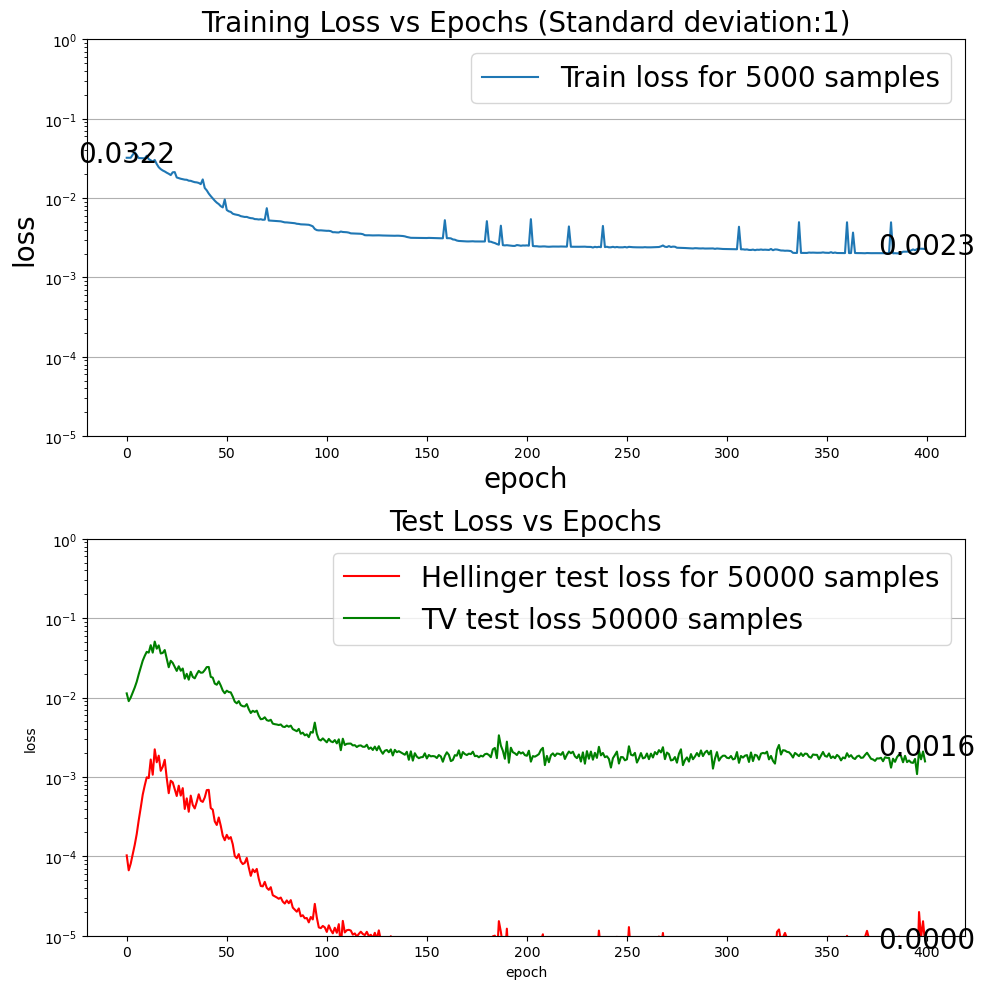

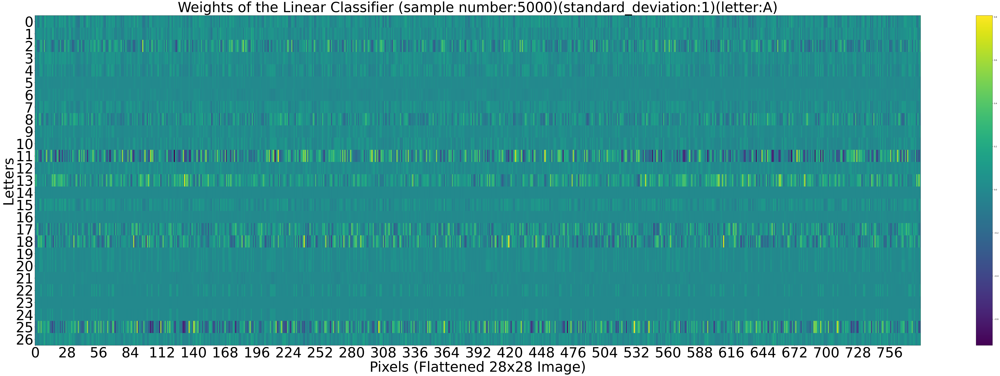

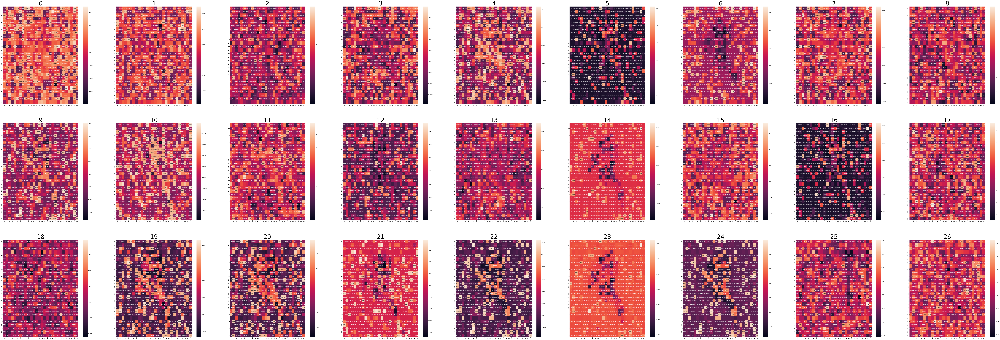

generate training
generate testing
Epoch [1/400]: The training loss is 0.3697
Epoch [2/400]: The training loss is 0.3382
Epoch [3/400]: The training loss is 0.3319
Epoch [4/400]: The training loss is 0.3224
Epoch [5/400]: The training loss is 0.3205
Epoch [6/400]: The training loss is 0.3185
Epoch [7/400]: The training loss is 0.3170
Epoch [8/400]: The training loss is 0.3085
Epoch [9/400]: The training loss is 0.3072
Epoch [10/400]: The training loss is 0.3047
Epoch [11/400]: The training loss is 0.3043
Epoch [12/400]: The training loss is 0.3037
Epoch [13/400]: The training loss is 0.3008
Epoch [14/400]: The training loss is 0.2980
Epoch [15/400]: The training loss is 0.2977
Epoch [16/400]: The training loss is 0.2972
Epoch [17/400]: The training loss is 0.2943
Epoch [18/400]: The training loss is 0.2919
Epoch [19/400]: The training loss is 0.2926
Epoch [20/400]: The training loss is 0.2902
Epoch [21/400]: The training loss is 0.2902
Epoch [22/400]: The training loss is 0.2871
Epoch 

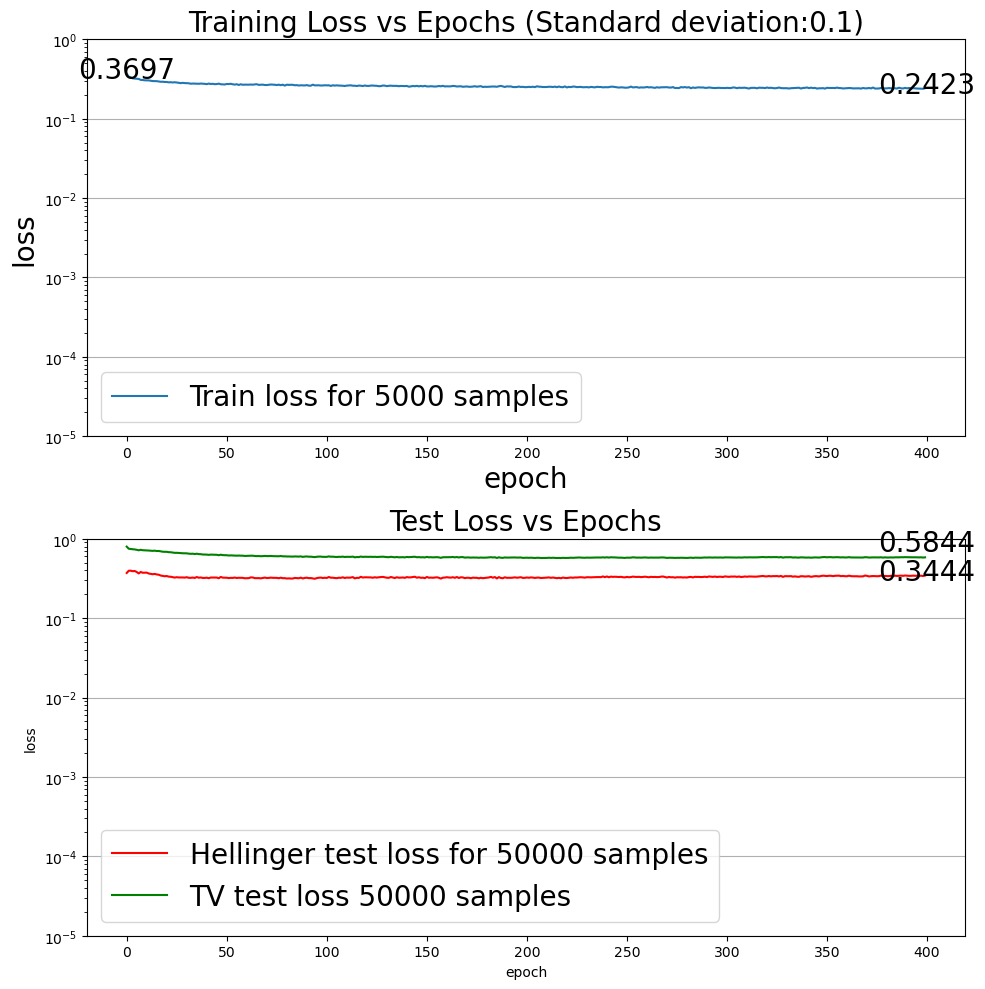

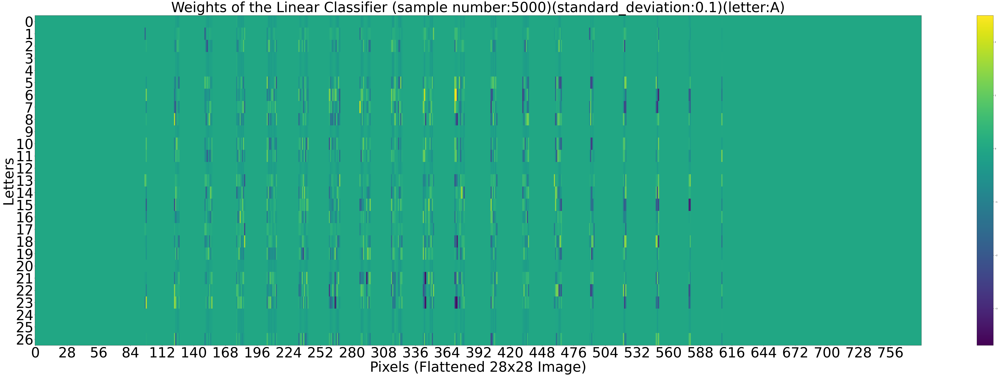

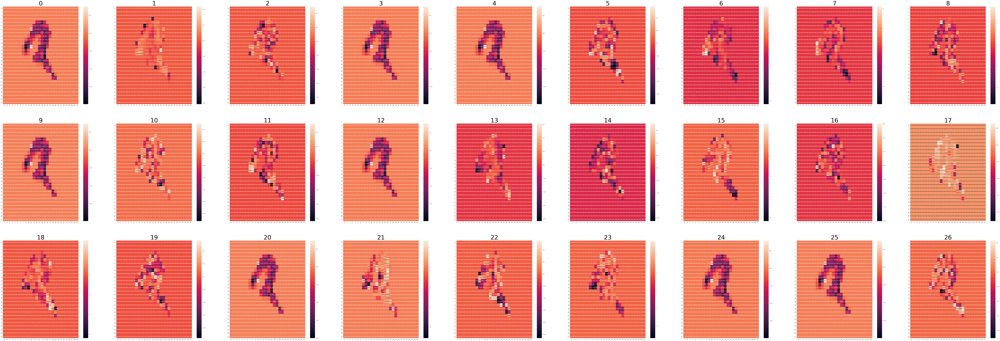

generate training
generate testing
Epoch [1/400]: The training loss is 0.4089
Epoch [2/400]: The training loss is 0.3869
Epoch [3/400]: The training loss is 0.3775
Epoch [4/400]: The training loss is 0.3749
Epoch [5/400]: The training loss is 0.3702
Epoch [6/400]: The training loss is 0.3643
Epoch [7/400]: The training loss is 0.3608
Epoch [8/400]: The training loss is 0.3585
Epoch [9/400]: The training loss is 0.3541
Epoch [10/400]: The training loss is 0.3514
Epoch [11/400]: The training loss is 0.3474
Epoch [12/400]: The training loss is 0.3433
Epoch [13/400]: The training loss is 0.3414
Epoch [14/400]: The training loss is 0.3423
Epoch [15/400]: The training loss is 0.3397
Epoch [16/400]: The training loss is 0.3392
Epoch [17/400]: The training loss is 0.3348
Epoch [18/400]: The training loss is 0.3342
Epoch [19/400]: The training loss is 0.3326
Epoch [20/400]: The training loss is 0.3298
Epoch [21/400]: The training loss is 0.3301
Epoch [22/400]: The training loss is 0.3295
Epoch 

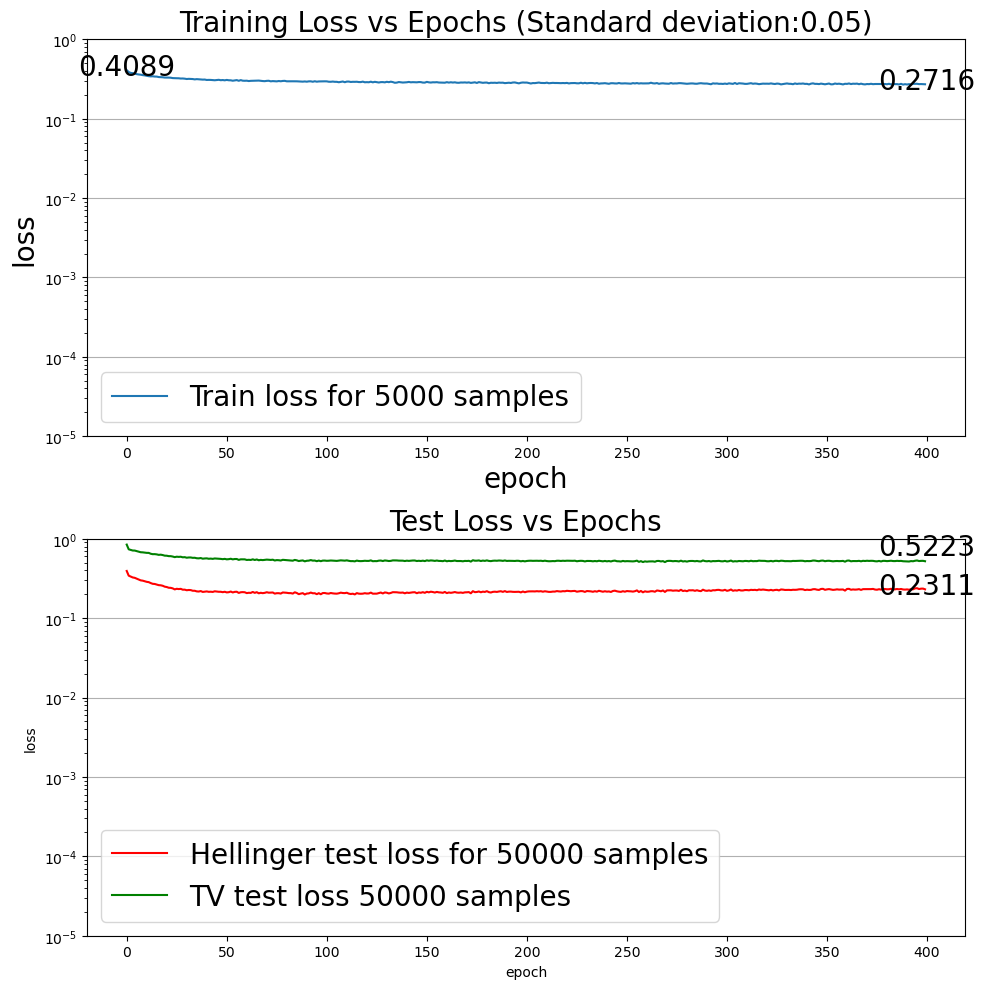

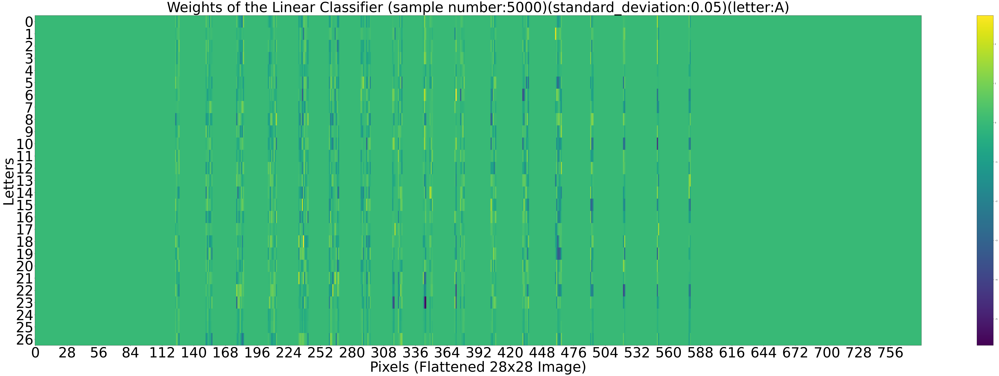

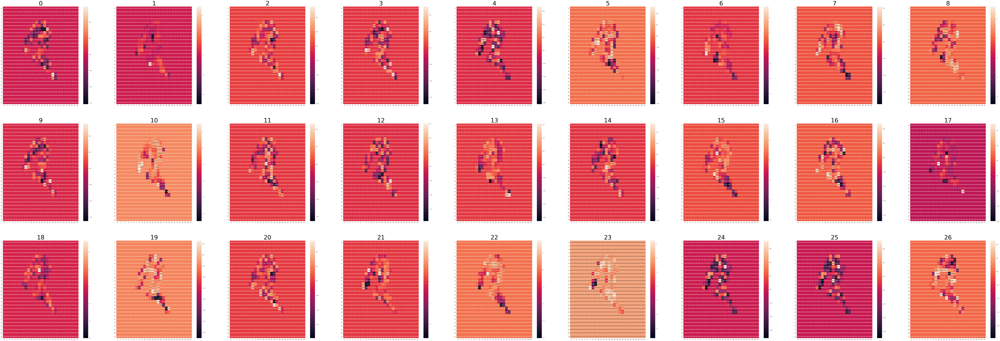

generate training
generate testing
Epoch [1/400]: The training loss is 0.4474
Epoch [2/400]: The training loss is 0.4131
Epoch [3/400]: The training loss is 0.3988
Epoch [4/400]: The training loss is 0.3868
Epoch [5/400]: The training loss is 0.3770
Epoch [6/400]: The training loss is 0.3713
Epoch [7/400]: The training loss is 0.3617
Epoch [8/400]: The training loss is 0.3572
Epoch [9/400]: The training loss is 0.3556
Epoch [10/400]: The training loss is 0.3489
Epoch [11/400]: The training loss is 0.3436
Epoch [12/400]: The training loss is 0.3415
Epoch [13/400]: The training loss is 0.3385
Epoch [14/400]: The training loss is 0.3354
Epoch [15/400]: The training loss is 0.3311
Epoch [16/400]: The training loss is 0.3297
Epoch [17/400]: The training loss is 0.3240
Epoch [18/400]: The training loss is 0.3269
Epoch [19/400]: The training loss is 0.3249
Epoch [20/400]: The training loss is 0.3228
Epoch [21/400]: The training loss is 0.3217
Epoch [22/400]: The training loss is 0.3204
Epoch 

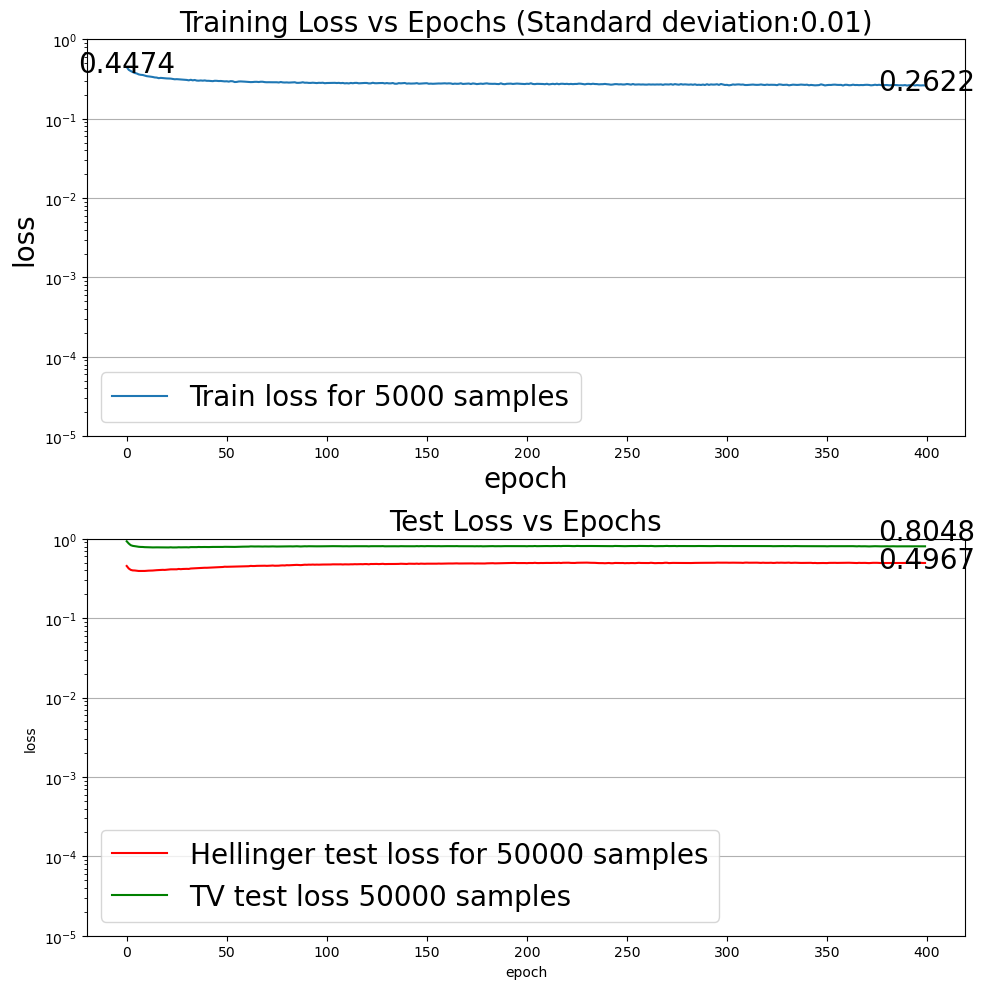

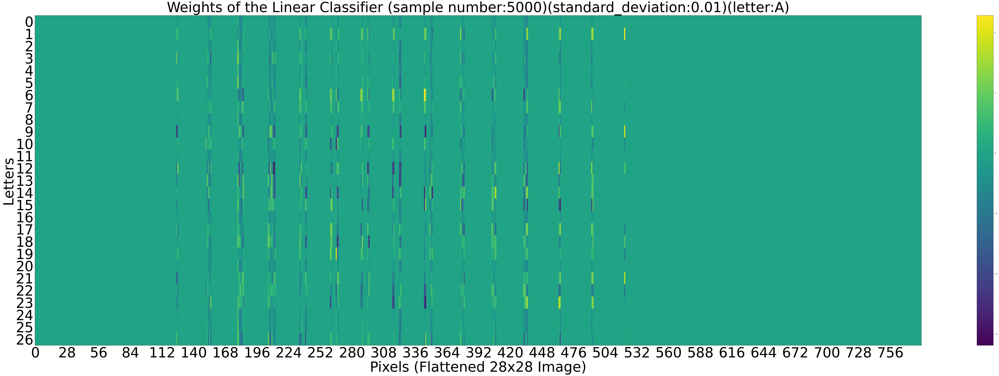

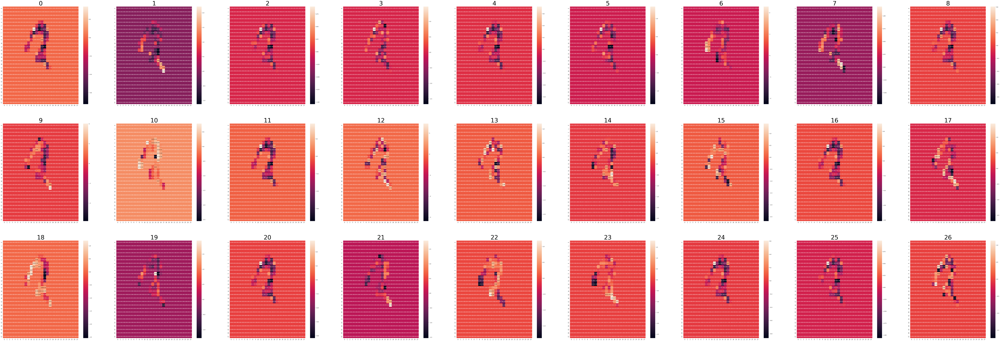

generate training
generate testing
Epoch [1/400]: The training loss is 0.4516
Epoch [2/400]: The training loss is 0.4143
Epoch [3/400]: The training loss is 0.3806
Epoch [4/400]: The training loss is 0.3584
Epoch [5/400]: The training loss is 0.3424
Epoch [6/400]: The training loss is 0.3306
Epoch [7/400]: The training loss is 0.3185
Epoch [8/400]: The training loss is 0.3129
Epoch [9/400]: The training loss is 0.3076
Epoch [10/400]: The training loss is 0.2997
Epoch [11/400]: The training loss is 0.2969
Epoch [12/400]: The training loss is 0.2900
Epoch [13/400]: The training loss is 0.2863
Epoch [14/400]: The training loss is 0.2818
Epoch [15/400]: The training loss is 0.2814
Epoch [16/400]: The training loss is 0.2751
Epoch [17/400]: The training loss is 0.2764
Epoch [18/400]: The training loss is 0.2750
Epoch [19/400]: The training loss is 0.2712
Epoch [20/400]: The training loss is 0.2685
Epoch [21/400]: The training loss is 0.2662
Epoch [22/400]: The training loss is 0.2662
Epoch 

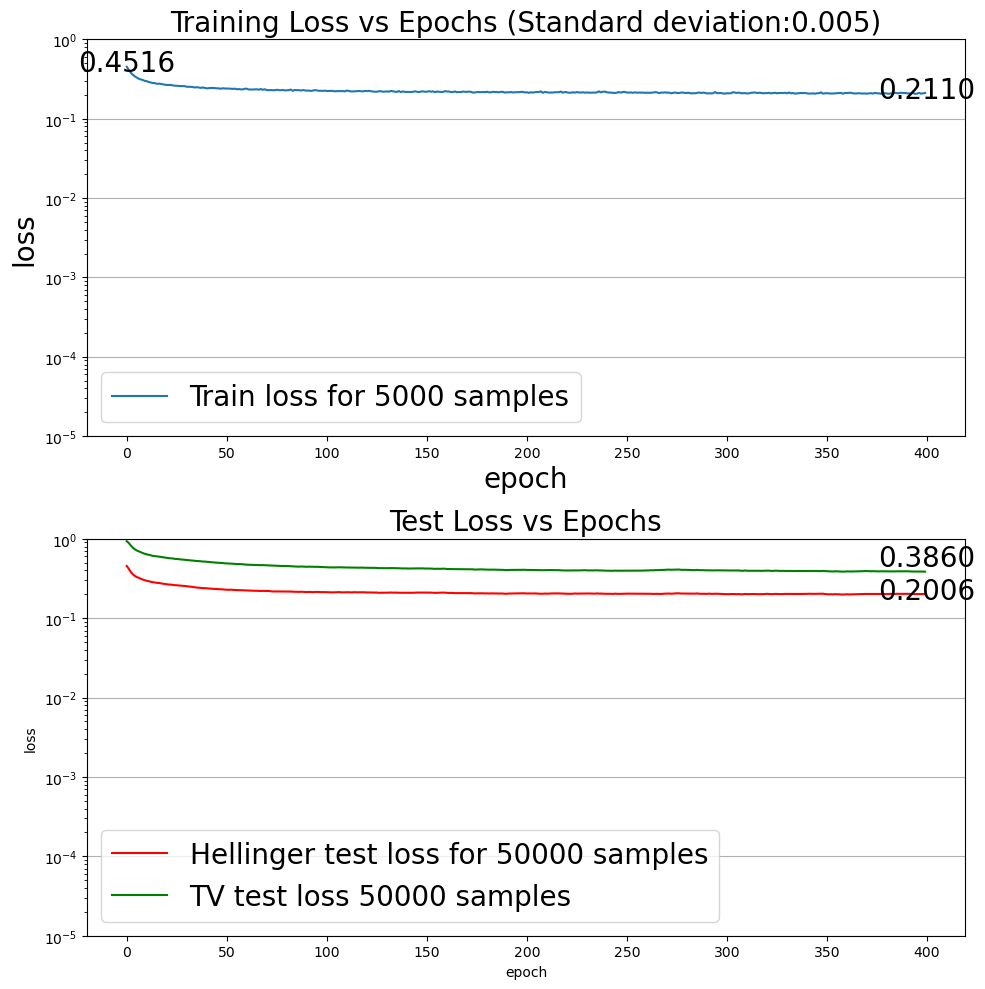

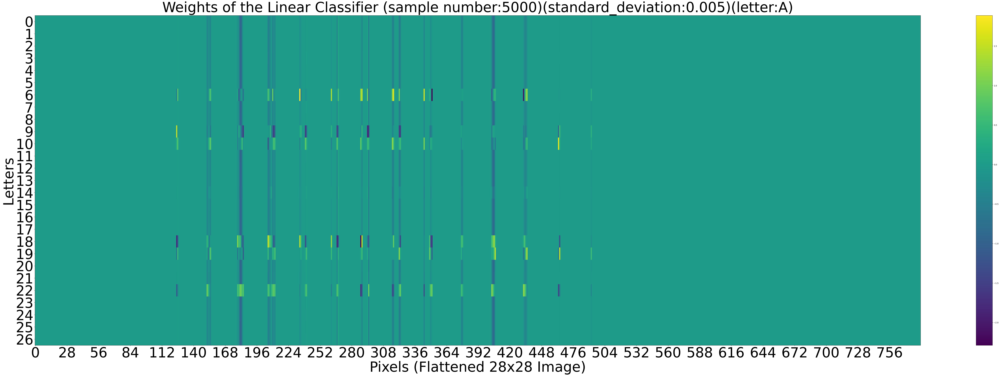

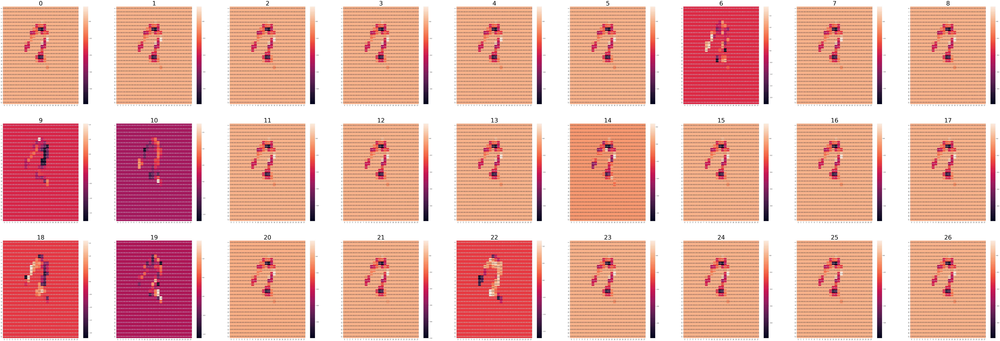

generate training
generate testing
Epoch [1/400]: The training loss is 0.4714
Epoch [2/400]: The training loss is 0.4575
Epoch [3/400]: The training loss is 0.4373
Epoch [4/400]: The training loss is 0.4088
Epoch [5/400]: The training loss is 0.3710
Epoch [6/400]: The training loss is 0.3256
Epoch [7/400]: The training loss is 0.2775
Epoch [8/400]: The training loss is 0.2378
Epoch [9/400]: The training loss is 0.2019
Epoch [10/400]: The training loss is 0.1738
Epoch [11/400]: The training loss is 0.1536
Epoch [12/400]: The training loss is 0.1353
Epoch [13/400]: The training loss is 0.1209
Epoch [14/400]: The training loss is 0.1077
Epoch [15/400]: The training loss is 0.0989
Epoch [16/400]: The training loss is 0.0894
Epoch [17/400]: The training loss is 0.0835
Epoch [18/400]: The training loss is 0.0752
Epoch [19/400]: The training loss is 0.0705
Epoch [20/400]: The training loss is 0.0654
Epoch [21/400]: The training loss is 0.0607
Epoch [22/400]: The training loss is 0.0584
Epoch 

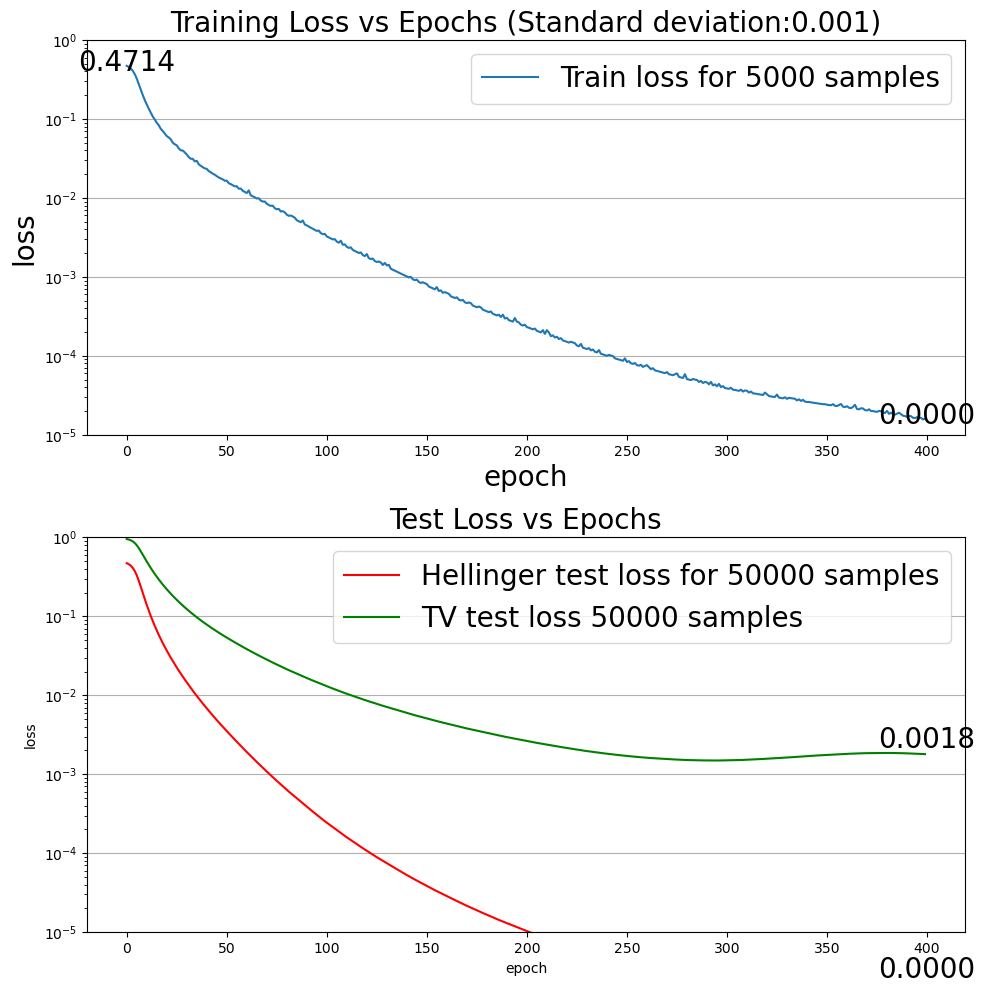

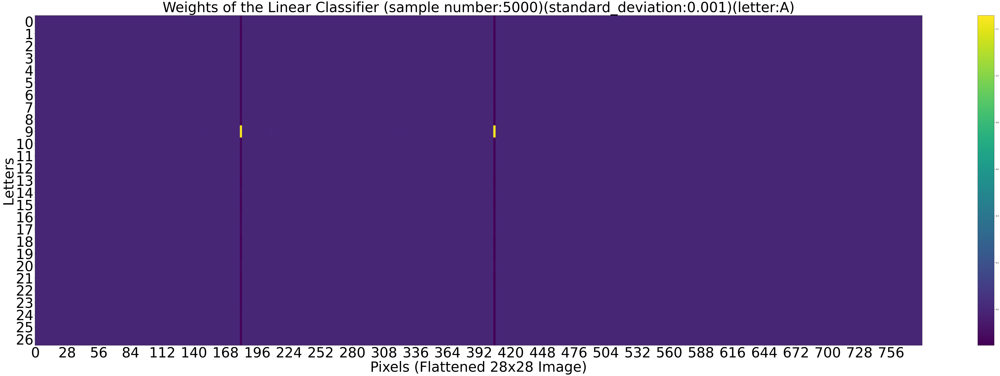

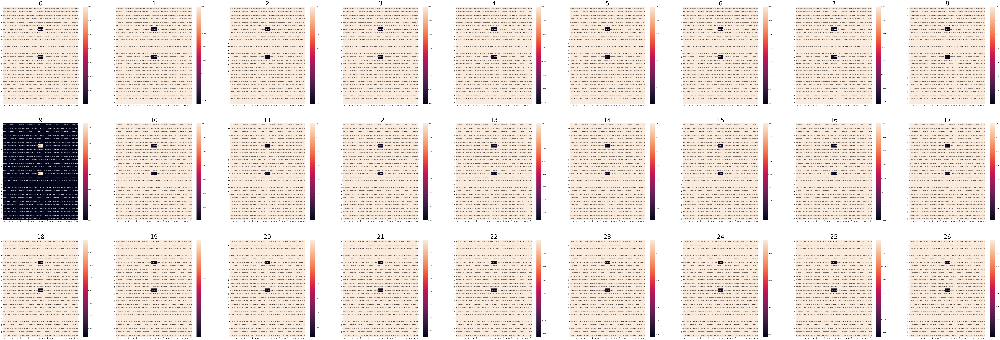

generate training
generate testing
Epoch [1/400]: The training loss is 0.4717
Epoch [2/400]: The training loss is 0.4578
Epoch [3/400]: The training loss is 0.4377
Epoch [4/400]: The training loss is 0.4094
Epoch [5/400]: The training loss is 0.3704
Epoch [6/400]: The training loss is 0.3253
Epoch [7/400]: The training loss is 0.2799
Epoch [8/400]: The training loss is 0.2380
Epoch [9/400]: The training loss is 0.2025
Epoch [10/400]: The training loss is 0.1738
Epoch [11/400]: The training loss is 0.1544
Epoch [12/400]: The training loss is 0.1349
Epoch [13/400]: The training loss is 0.1189
Epoch [14/400]: The training loss is 0.1057
Epoch [15/400]: The training loss is 0.0967
Epoch [16/400]: The training loss is 0.0883
Epoch [17/400]: The training loss is 0.0800
Epoch [18/400]: The training loss is 0.0756
Epoch [19/400]: The training loss is 0.0685
Epoch [20/400]: The training loss is 0.0655
Epoch [21/400]: The training loss is 0.0589
Epoch [22/400]: The training loss is 0.0556
Epoch 

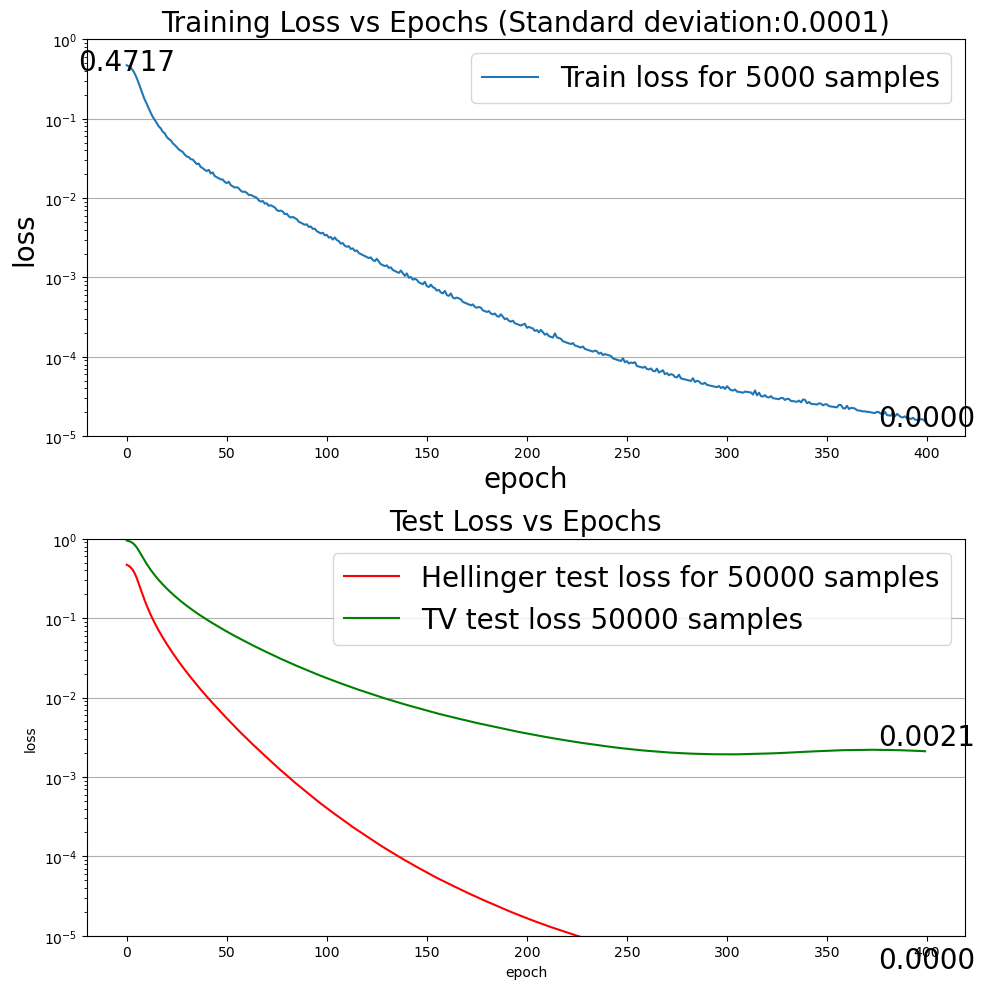

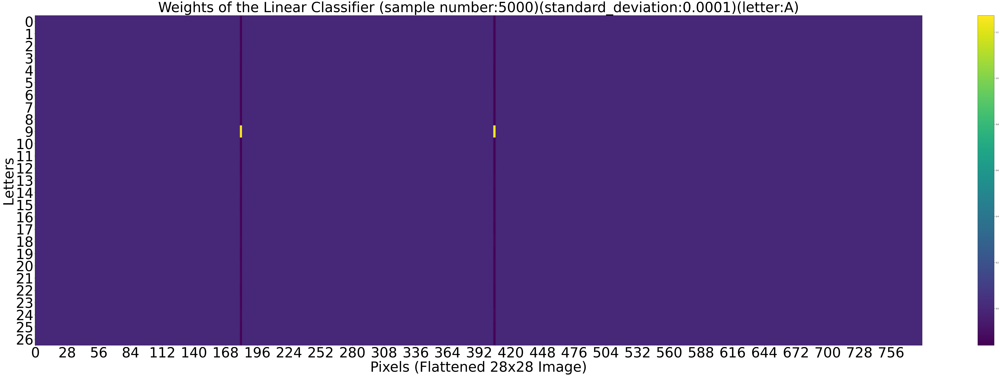

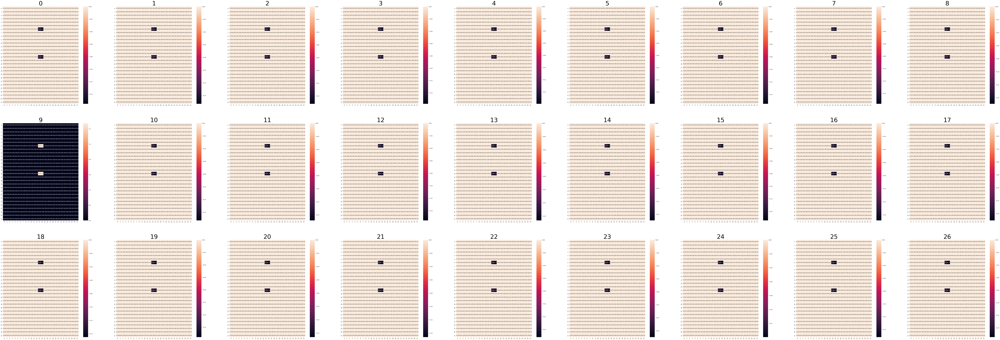

In [17]:

def whole_process(sample_number, sd, img1,digit):
    #criterion_train = SquaredHellingerLoss()
    
    letter = chr(digit + ord('A') - 1)
    criterion_train = SquaredLoss()
    criterion_test = TVDistanceLoss()
    simple_model = LinearClassifier(input_size, 27).to(device)
    dirs = 'EMNIST/C-LIME/5000_0-'+str(sd)[2:len(str(sd))]

    if not os.path.exists(dirs):
        os.makedirs(dirs)

    train_sample_number = sample_number
    Train_DL = create_pertubation(img1,train_sample_number,0,sd,load_model)
    print('generate training')
    test_DL = create_pertubation(img1,10,0,sd,load_model) #
    print('generate testing')

    if sample_number==5000:
        training_epoch=400
    else:
        training_epoch=250

    simple_train_loss, simple_test_loss, TV_test_loss = Complex_Neural_Training(training_epoch, 0.001, simple_model,
            Train_DL, criterion_train,criterion_test, torch.optim.Adam(simple_model.parameters(), lr=0.001),test_DL,0.0001)

    fig, axs = plt.subplots(2, 1, figsize=(10, 10))
    font_size = 20
#axs[0,0].plot(u_train_loss, '-bx')
    axs[0].plot(simple_train_loss)


    axs[0].set_xlabel('epoch',fontsize=font_size)
    axs[0].set_ylabel('loss',fontsize=font_size)
#axs[0].legend([f'{train_sample_number} train samples'])
    axs[0].legend([f'Train loss for {sample_number} samples' ],fontsize=font_size)
    axs[0].set_title('Training Loss vs Epochs (Standard deviation:'+str(sd)+')',fontsize=font_size)
    axs[0].yaxis.grid(True)
    axs[0].text(len(simple_train_loss), 1.1*simple_train_loss[-1], f'{simple_train_loss[-1]:.4f}', ha='center', va='center', color='black', fontsize=font_size)
    axs[0].text(0, 1.1*simple_train_loss[0], f'{simple_train_loss[0]:.4f}', ha='center', va='center', color='black', fontsize=font_size)
# axs[0].text(150, 0.02, f'{simple_train_loss[150]:.4f}', ha='center', va='center', color='black', fontsize=10)
# axs[0].text(200, 0.01, f'{simple_train_loss[200]:.4f}', ha='center', va='center', color='black', fontsize=10)
# axs[0].text(250, 0.01, f'{simple_train_loss[250]:.4f}', ha='center', va='center', color='black', fontsize=10)
    axs[0].set_ylim(0.00001,1)
    axs[0].set_yscale("log",base=10)

#axs[0].text(800, 0.1, f'{simple_train_loss[800]:.4f}', ha='center', va='center', color='black', fontsize=10)


#axs[0,1].plot(u_test_loss, '-bx')
    axs[1].plot(simple_test_loss, color='red')
    axs[1].plot(TV_test_loss, color='green')
    axs[1].set_xlabel('epoch')
    axs[1].set_ylabel('loss')
    axs[1].legend([f'Hellinger test loss for {10*sample_number} samples',f'TV test loss {10*sample_number} samples'],fontsize=font_size)
    axs[1].set_title('Test Loss vs Epochs',fontsize=font_size)
    axs[1].yaxis.grid(True)
    axs[1].set_ylim(0.00001,1)
    axs[1].set_yscale("log",base=10)
#axs[1].text(50len(simple_test_loss)0, 0.1, f'{simple_test_loss[-1]:.4f}', ha='center', va='center', color='black', fontsize=10)
#axs[1].text(0, 1.1, f'{simple_test_loss[0]:.4f}', ha='center', va='center', color='black', fontsize=10)
    axs[1].text(len(simple_test_loss), 1.1*simple_test_loss[-1], f'{simple_test_loss[-1]:.4f}', ha='center', va='center', color='black', fontsize=font_size)
    axs[1].text(len(TV_test_loss), 1.5*TV_test_loss[-1], f'{TV_test_loss[-1]:.4f}', ha='center', va='center', color='black', fontsize=font_size)
#axs[1].text(150, 0.02, f'{simple_test_loss[150]:.4f}', ha='center', va='center', color='black', fontsize=10)
#axs[1].text(200, 0.01, f'{simple_test_loss[200]:.4f}', ha='center', va='center', color='black', fontsize=10)
#axs[1].text(250, 0.01, f'{simple_test_loss[250]:.4f}', ha='center', va='center', color='black', fontsize=10)
    
    plt.tight_layout()
    plt.savefig(f'EMNIST/C-LIME/5000_0-'+str(sd)[2:len(str(sd))]+'/loss'+letter)
    draw_weight(simple_model,sample_number,sd,digit)
    draw_reshape_weight(simple_model,digit,sd)


sn = [5000]
#sd = [0.1,0.05,0.01,0.005,0.001,0.0001]
sd = [1,0.1,0.05,0.01,0.005,0.001,0.0001]
for i in sn:
    for j in sd:
        whole_process(i,j,image_set2[0],1)
        # digit=1

        # for img in range(0,26):
        #     whole_process(i,j,image_set2[img],digit)
        #     digit =digit+1



In [16]:
chr(11 + ord('A') - 1)

'K'

In [25]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
img1=image_set2[0]
sd=1
criterion_train = SquaredLoss()
criterion_train2 = SquaredHellingerLoss()
criterion_test = TVDistanceLoss()
t1 = time()
train_sample_number = 5000
training_epoch = 400
simple_model = LinearClassifier(input_size, 27).to(device)
Train_DL = create_pertubation(img1,train_sample_number,0,sd,load_model)
test_DL = create_pertubation(img1,10,0,sd,load_model) #
t2 = time()
# train_accuracy_dynamics, train_loss_dynamics = Neural_Training(training_epoch, eta, simple_model, 
#             Train_DL, criterion_train2, torch.optim.Adam(simple_model.parameters(), lr=0.001,weight_decay=0.0001))
simple_train_loss, simple_test_loss, TV_test_loss = Complex_Neural_Training(training_epoch, 0.001, simple_model, 
            Train_DL, criterion_train2,criterion_test, torch.optim.Adam(simple_model.parameters(), lr=0.001),test_DL,0.0001)
t3 = time()
print('Generating time:'+str(t2-t1),'Training time:',str(t3-t2))

Epoch [1/400]: The training loss is 0.0350
Epoch [2/400]: The training loss is 0.0340
Epoch [3/400]: The training loss is 0.0338
Epoch [4/400]: The training loss is 0.0337
Epoch [5/400]: The training loss is 0.0336
Epoch [6/400]: The training loss is 0.0335
Epoch [7/400]: The training loss is 0.0334
Epoch [8/400]: The training loss is 0.0334
Epoch [9/400]: The training loss is 0.0362
Epoch [10/400]: The training loss is 0.0362
Epoch [11/400]: The training loss is 0.0361
Epoch [12/400]: The training loss is 0.0332
Epoch [13/400]: The training loss is 0.0332
Epoch [14/400]: The training loss is 0.0332
Epoch [15/400]: The training loss is 0.0332
Epoch [16/400]: The training loss is 0.0331
Epoch [17/400]: The training loss is 0.0360
Epoch [18/400]: The training loss is 0.0331
Epoch [19/400]: The training loss is 0.0331
Epoch [20/400]: The training loss is 0.0331
Epoch [21/400]: The training loss is 0.0331
Epoch [22/400]: The training loss is 0.0330
Epoch [23/400]: The training loss is 0.03

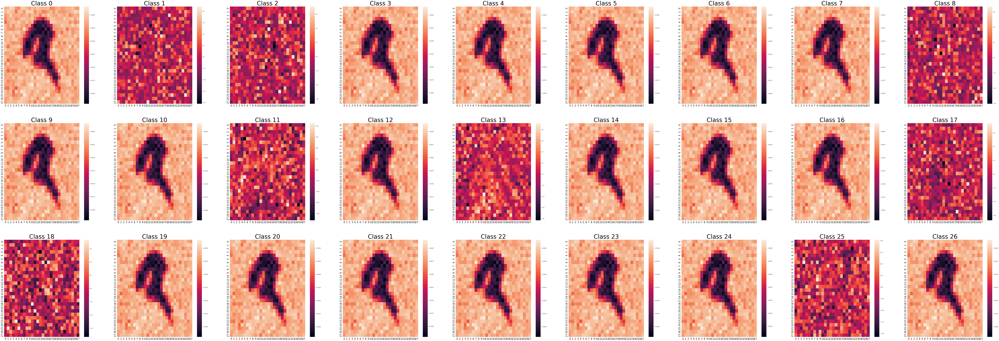

In [27]:
weights = simple_model.state_dict()['linear.weight'].cpu()

fig, axes = plt.subplots(3, 9, figsize=(150, 50))
for i, ax in enumerate(axes.flat):
    weight_image = weights[i, :].reshape(28, 28)
    sns.heatmap(weight_image, ax=ax) #,annot=True, fmt=".2f"
    ax.set_title(f'Class {i}',fontsize=50)
    ax.tick_params(axis='both',labelsize=20)

In [47]:
weights = simple_model.state_dict()['linear.weight'].cpu().clone()
print("original:",weights)
for i in range(weights.shape[0]):
    for j in range(weights.shape[1]):
        if weights[i,j]<0:
            weights[i,j]=0
print("new:",weights)

original: tensor([[-1.1446e-39, -4.4592e-40, -3.0719e-39,  ...,  7.3990e-40,
          2.6470e-39, -6.2171e-40],
        [ 3.0322e-39,  2.6977e-39,  5.2985e-40,  ..., -1.6025e-39,
          7.5333e-40, -4.5438e-40],
        [ 1.1062e-39,  4.6898e-40, -9.2927e-40,  ..., -7.4265e-40,
         -3.1305e-39,  9.2436e-40],
        ...,
        [ 7.7158e-41,  4.2362e-40, -9.9899e-40,  ..., -9.8956e-40,
         -7.8316e-40, -4.4565e-40],
        [ 3.5185e-40,  9.0932e-40, -1.1387e-39,  ...,  9.2273e-40,
          4.1394e-40, -7.3632e-40],
        [-7.0770e-40,  5.6915e-40, -1.0817e-39,  ..., -3.9962e-40,
         -5.9464e-40, -3.0396e-39]])
new: tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 7.3990e-40, 2.6470e-39,
         0.0000e+00],
        [3.0322e-39, 2.6977e-39, 5.2985e-40,  ..., 0.0000e+00, 7.5333e-40,
         0.0000e+00],
        [1.1062e-39, 4.6898e-40, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         9.2436e-40],
        ...,
        [7.7158e-41, 4.2362e-40, 0.0000e+00,  ...

In [48]:
fig, axes = plt.subplots(2, 13, figsize=(250, 40))
for i, ax in enumerate(axes.flat):
    weight_image = weights[i, :].reshape(28, 28)
    sns.heatmap(weight_image, ax=ax,annot=True, fmt=".2f")
    ax.set_title(f'Class {i}',fontsize=50)
    ax.tick_params(axis='both',labelsize=30)

In [14]:
#sample_number = [100,500,1000,5000,10000]
L2_regularzation = [0.0001,0.001,0.005,0.01,0.05]#
#weight_decay= [0.0001,0.001,0.005,0.01,0.05]#,
img1= image_set2[0]
train_loss=[]
Htest_loss=[]
TV_loss=[]
for l2 in L2_regularzation:
    criterion_train = SquaredHellingerLoss()
    criterion_test = TVDistanceLoss()
    Train_DL = create_pertubation(img1,5000,0,0.001,load_model)
    Test_DL = create_pertubation(img1,10*5000,0,0.001,load_model)
    model = LinearClassifier(input_size, 62).to(device)
    simple_train_loss, simple_test_loss, TV_test_loss = Complex_Neural_Training (400, 0.001, model, Train_DL, criterion_train,criterion_test, torch.optim.Adam(model.parameters(), lr=0.001),Test_DL,l2)
    train_loss.append(simple_train_loss)
    Htest_loss.append(simple_test_loss)
    TV_loss.append(TV_test_loss)


Epoch [1/400]: The training loss is 0.8578
Epoch [2/400]: The training loss is 0.8393
Epoch [3/400]: The training loss is 0.8175
Epoch [4/400]: The training loss is 0.7913
Epoch [5/400]: The training loss is 0.7607
Epoch [6/400]: The training loss is 0.7258
Epoch [7/400]: The training loss is 0.6892
Epoch [8/400]: The training loss is 0.6541
Epoch [9/400]: The training loss is 0.6179
Epoch [10/400]: The training loss is 0.5846
Epoch [11/400]: The training loss is 0.5543
Epoch [12/400]: The training loss is 0.5312
Epoch [13/400]: The training loss is 0.5082
Epoch [14/400]: The training loss is 0.4884
Epoch [15/400]: The training loss is 0.4708
Epoch [16/400]: The training loss is 0.4576
Epoch [17/400]: The training loss is 0.4451
Epoch [18/400]: The training loss is 0.4330
Epoch [19/400]: The training loss is 0.4231
Epoch [20/400]: The training loss is 0.4118
Epoch [21/400]: The training loss is 0.4022
Epoch [22/400]: The training loss is 0.3939
Epoch [23/400]: The training loss is 0.38

In [15]:
def draw_l2(train_loss,Htest_loss,TV_loss,lambda_set):
    fig, axs = plt.subplots(3, 1, figsize=(10, 10),constrained_layout=True)
    for i in train_loss:
        axs[0].plot(i)
    axs[0].set_xlabel('epoch',fontsize=20)
    axs[0].set_ylabel('loss',fontsize=20)
    axs[0].tick_params(axis='both',labelsize=20)
#axs[0].legend([f'{train_sample_number} train samples'])
    axs[0].legend(['λ='+str(i) for i in lambda_set],fontsize=20)
    axs[0].set_title('Training Loss vs Epochs ',fontsize=20)
    #axs[0].text(len(train_loss), 1.1*train_loss[-1], f'{train_loss[-1]:.4f}', ha='center', va='center', color='black', fontsize=20)
    axs[0].yaxis.grid(True)
    axs[0].set_ylim(0.0001,1) 
    axs[0].set_yscale("log",base=10)

#axs[1].plot(train_loss_dynamics, color='red')
    for i in Htest_loss:
        axs[1].plot(i)
    #axs[1].plot(TV_test_loss, color='green')
    axs[1].set_xlabel('epoch',fontsize=20)
    axs[1].set_ylabel('loss',fontsize=20)
    axs[1].tick_params(axis='both',labelsize=20)
    axs[1].legend(['λ='+str(i) for i in lambda_set],fontsize=20)
    axs[1].set_title('Hellinger Test Loss vs Epochs',fontsize=20)
    #axs[1].text(len(Htest_loss), 1.1*Htest_loss[-1], f'{Htest_loss[-1]:.4f}', ha='center', va='center', color='black', fontsize=20)
    #axs[1].text(len(TV_test_loss), 1.1*TV_test_loss[-1], f'{TV_test_loss[-1]:.4f}', ha='center', va='center', color='black', fontsize=20)
#axs[1].text(400, 1.1*train_loss_dynamics[399], f'{train_loss_dynamics[399]:.4f}', ha='center', va='center', color='black', fontsize=10)
#axs[1].text(351, 1.1*simple_test_loss[350], f'{simple_test_loss[350]:.5f}', ha='center', va='center', color='black', fontsize=20)
    axs[1].yaxis.grid(True)
    axs[1].set_ylim(0.0001,1) 
    axs[1].set_yscale("log",base=10)

    #axs[2].plot(Htest_loss, color='red')
    for i in TV_loss:
        axs[2].plot(i)
    axs[2].set_xlabel('epoch',fontsize=20)
    axs[2].set_ylabel('loss',fontsize=20)
    axs[2].tick_params(axis='both',labelsize=20)
    axs[2].legend(['λ='+str(i) for i in lambda_set],fontsize=20)
    axs[2].set_title('TV Test Loss vs Epochs',fontsize=20)
    #axs[2].text(len(Htest_loss), 1.1*Htest_loss[-1], f'{Htest_loss[-1]:.4f}', ha='center', va='center', color='black', fontsize=20)
    #axs[2].text(len(TV_loss), 1.1*TV_loss[-1], f'{TV_loss[-1]:.4f}', ha='center', va='center', color='black', fontsize=20)
    axs[2].yaxis.grid(True)
    axs[2].set_ylim(0.0001,1) 
    axs[2].set_yscale("log",base=10)

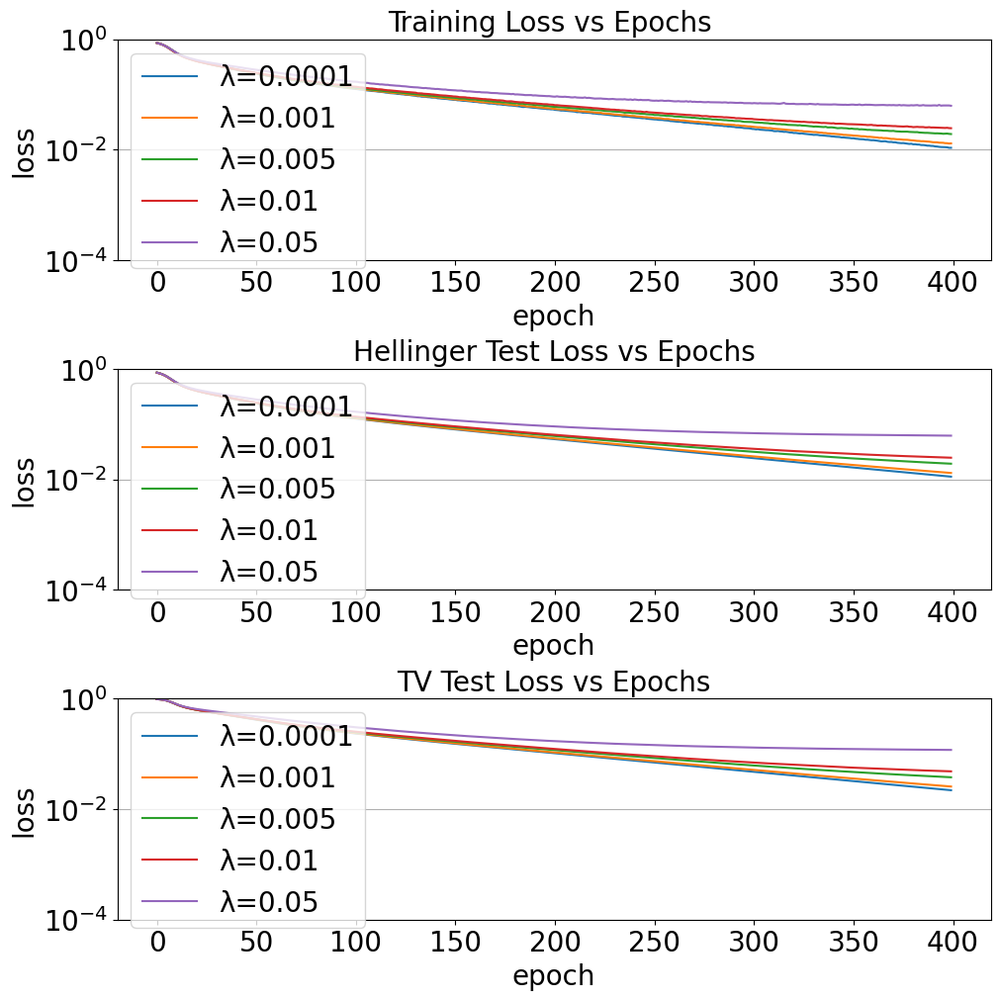

In [17]:
draw_l2(train_loss,Htest_loss,TV_loss,L2_regularzation)